# Formamentis Networks for Emotional Alignment in Language Models

In [26]:
# Check the direcotry of the enviroment
import sys
print(sys.executable)

/Users/matteomassari/Desktop/Hackaton final/.venv/bin/python


To what extent is a **Large Language Model (LLM)** capable of generating text that is **emotionally coherent** with the type of prompt provided — whether **positive** or **negative**?
What is the role of the **temperature parameter** in modulating the **intensity and quality** of the emotion expressed in the generated text?

To explore this question, I proposed a consistent narrative scenario to the LLM:

> _"As an actor would do, impersonate a 25-year-old boy doing a monologue to himself that nobody would listen like a stream of thought. He works as a data scientist in a large company in London."_

This scenario was framed under three distinct emotional conditions:
- **Positive prompt**
- **Negative prompt**

The goal is to analyze whether, through the use of the **forma mentis network**, it is possible to **retrieve the underlying emotional structure** of each prompt and determine whether the LLM is capable of abstract the emotions that a specific text might have.
To assert that will be used tow prompt that describe similar situation. A positive prompt describe a positive situation and a negative describe a negative situation both of them without declare what emotion should describe the llm.

**Positive Prompt**
_As an actor would do, impersonate a 25-year-old boy doing a monologue to himself that nobody would listen like a stream of thought. He works as a data scientist in a large company in London. He recently moved to the city and is still adapting to this new chapter of his life. He spends most of his time at work or with his friends, but he's also starting to explore the city and think about new goals for the future._

**Negative Prompt**
_"As an actor would do, impersonate a 25-year-old boy doing a monologue to himself that nobody would listen like a stream of thought. He works as a data scientist in a large company in London. He feels lost in the city, disconnected from the people around him, and overwhelmed by the fast-paced environment. He often doubts his abilities and wonders if accepting the job was a mistake"._

The resarch is devided in:
- Global semantic analysis, to assess how temperature influences the overall characteristics and coherence of the generated text.
- Key term analysis, to identify the most salient or frequently recurring words across outputs.
- Forma Mentis Network exploration, to visualize emotion-laden associations of selected keywords and examine their emotional coherence.
- Classification-based validation, using confusion matrices and emotion-based reclassification to evaluate whether the outputs align with the intended emotional direction of the prompts.



In [27]:
# Requirements
###############################################
# to use emoatlas
# - pip install git+https://github.com/MassimoStel/emoatlas
# - python -m spacy download en_core_web_lg
###############################################

import pandas as pd
import numpy as np
import torch
import nltk
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns

from nltk.tokenize import sent_tokenize
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.metrics import confusion_matrix, classification_report
from tqdm.notebook import tqdm
from scipy.special import softmax
from wordfreq import zipf_frequency

import pyplutchik as pyplutchik
import emoatlas as et
from analysis_pack.functions import *


nltk.download('wordnet')
# analysis_pack enchance EmoAtlas package, allowing us to elaborate more graph maintaining the properties of the forma mentis graph untouched (All the funtion in the packages contain EmoAtlas function)


[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [28]:
dataset = pd.read_csv("data/data_chat_neutral.csv", on_bad_lines='skip')

dataset["text"] = dataset["text"].str.replace(r'\bjob\b', 'work', regex=True) # I know probably is a bit like cheating, but I want to keep it simple

emos = et.EmoScores() # create a class
temperature_level = [0.1,0.7,1.3]
prompt_types = ["positive", "negative"]



## Forma mentis Analysis

In [29]:
# Dealing with text corpora
def create_networks(dataset, prompt_type, temperature):
    filtered_df = dataset[(dataset["type of prompt"] == prompt_type) &
                          (dataset["temperature"] == temperature)].copy().reset_index(drop=True)
    fMNT_networks = []
    synonyms_networks = []
    for i, row in filtered_df.iterrows():
        fmnt = emos.formamentis_network(
            row["text"]
        )
        fMNT_networks.append(fmnt)

        fmnt_synonyms = emos.formamentis_network(
            row["text"],
            semantic_enrichment='synonyms'
            ,multiplex=True)
        fmnt_synonyms = fmnt_synonyms.edges["synonyms"]

        synonyms_networks.append(fmnt_synonyms)

    fMNT_networks_res = emos.combine_formamentis(fMNT_networks)
    return fMNT_networks_res, synonyms_networks

# This function allow me to create a forma mentis network combined with a global semantic network


### Global semantic analysis
To start the analysis is useful understand via global metrics the differences beetween prompts and temperature:
- n_edges: number of connection in the graph
- n_nodes: number of words in the text corpora
- density: it evaluate if a network is sparse or dense so if the node are connceted between them

In [30]:
prompt_types = ["positive", "negative"]

def global_semantic_analysis(prompt_type, temp):
    fMNT_networks_res, synonyms_networks = create_networks(dataset, prompt_type, temp)

    G = nx.Graph()
    G.add_edges_from(fMNT_networks_res.edges)

    is_connected = nx.is_connected(G) if G.number_of_nodes() > 0 else False

    if not is_connected and G.number_of_nodes() > 0:
        largest_cc = max(nx.connected_components(G), key=len)
        G = G.subgraph(largest_cc).copy()

    n_edges = G.number_of_edges()
    n_nodes = G.number_of_nodes()
    density = nx.density(G) if n_nodes > 1 else 0

    return {
        "type_of_prompt": prompt_type,
        "temperature": temp,
        "n_edges": n_edges,
        "n_nodes": n_nodes,
        "density": density,
    }


results = []

for prompt_type in tqdm(prompt_types, desc="Tipo di prompt"):
    for temp in tqdm(temperature_level, desc=f"Temperature for {prompt_type}", leave=False):
        result = global_semantic_analysis(prompt_type, temp)
        results.append(result)

# results
df_results = pd.DataFrame(results)
display(df_results)


Tipo di prompt:   0%|          | 0/2 [00:00<?, ?it/s]

Temperature for positive:   0%|          | 0/3 [00:00<?, ?it/s]

Temperature for negative:   0%|          | 0/3 [00:00<?, ?it/s]

,type_of_prompt,temperature,n_edges,n_nodes,density
0,positive,0.1,12138,1460,0.011396
1,positive,0.7,15287,1671,0.010956
2,positive,1.3,432485,28470,0.001067
3,negative,0.1,13310,1462,0.012463
4,negative,0.7,17650,1820,0.010663
5,negative,1.3,442470,28579,0.001084


From these table it seems that the metrics seems to be quite the same for all type of temperature and there seems not to be a real difference. Overall we can observe from the number of nodes that the words grows up when the temperature get higher.

###

In [31]:
df_results

,type_of_prompt,temperature,n_edges,n_nodes,density
0,positive,0.1,12138,1460,0.011396
1,positive,0.7,15287,1671,0.010956
2,positive,1.3,432485,28470,0.001067
3,negative,0.1,13310,1462,0.012463
4,negative,0.7,17650,1820,0.010663
5,negative,1.3,442470,28579,0.001084


In [43]:
df_results.to_csv("results/global_graph_metrics.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'graph_metrics.csv'


### Analysis of the network feature type

#### Frequency

In [32]:
from collections import Counter
import pandas as pd
from tqdm import tqdm

temperature_levels = [0.1, 0.7, 1.3]
results = []

for prompt_type in tqdm(["positive", "negative"], desc="Prompt Types"):
    for temp in tqdm(temperature_levels, desc=f"Temperatures for {prompt_type}", leave=False):
        # Filtra i testi
        filtered_df = dataset[(dataset["type of prompt"] == prompt_type) &
                              (dataset["temperature"] == temp)]

        if filtered_df.empty:
            continue

        # Lemmatizza il testo (qui prendo solo il primo per semplicità)
        lemmatized = emos.lemmatize_text(filtered_df.text.iloc[0])

        # Conta le parole
        word_counts = Counter(lemmatized)

        # Salva risultati per ogni parola
        for word, freq in word_counts.items():
            results.append({
                "prompt_type": prompt_type,
                "temperature": temp,
                "word": word,
                "frequency": freq
            })

# Crea il DataFrame finale
df_frequencies = pd.DataFrame(results)

# Ordina per temperatura, tipo di prompt e frequenza decrescente
df_frequencies_sorted = df_frequencies.sort_values(by=["temperature", "prompt_type", "frequency"],
                                                   ascending=[True, True, False])

# Visualizza
display(df_frequencies_sorted)





Prompt Types: 100%|██████████| 2/2 [00:10<00:00,  5.16s/it]             


,prompt_type,temperature,word,frequency
925,negative,0.1,I,56
1003,negative,0.1,maybe,7
923,negative,0.1,it,6
937,negative,0.1,work,6
948,negative,0.1,help,5
...,...,...,...,...
916,positive,1.3,tor,1
917,positive,1.3,soph,1
918,positive,1.3,goodly,1
919,positive,1.3,prof,1


In [44]:
df_frequencies_sorted.to_csv("results/local_metrics/frequencies.csv", index=False)
print("Risultati salvati in 'graph_metrics.csv'")

Risultati salvati in 'graph_metrics.csv'


#### Degree

In [33]:
# Evaluate the degree of a node
import pandas as pd
import networkx as nx
from tqdm import tqdm

# Lista per salvare i risultati
top10_words_degree = []

# Ciclo con barre di avanzamento
for prompt_type in tqdm(["positive", "negative"], desc="Prompt Types"):
    for temp in tqdm(temperature_level, desc=f"Temperatures for {prompt_type}", leave=False):
        # Crea grafo formamentis aggregato
        fMNT_networks_res, _ = create_networks(dataset, prompt_type, temp)
        G = nx.Graph()
        G.add_edges_from(fMNT_networks_res.edges)

        # Calcola le metriche nodo-per-nodo
        degrees = dict(G.degree())

        # Ordina i nodi per degree e prendi i primi 10
        top_10 = sorted(degrees.items(), key=lambda x: x[1], reverse=True)[:10]

        # Salva tutte le metriche per questi top 10
        for word, deg in top_10:
            top10_words_degree.append({
                "type_of_prompt": prompt_type,
                "temperature": temp,
                "word": word,
                "degree": deg,
            })

# Converto in DataFrame
df_top_degree = pd.DataFrame(top10_words_degree)
print(df_top_degree)




Prompt Types: 100%|██████████| 2/2 [43:47<00:00, 1313.96s/it]            

   type_of_prompt  temperature    word  degree
0        positive          0.1       I     888
1        positive          0.1      it     500
2        positive          0.1    work     269
3        positive          0.1    know     256
4        positive          0.1     try     251
5        positive          0.1   start     242
6        positive          0.1    city     227
7        positive          0.1    find     227
8        positive          0.1    feel     222
9        positive          0.1    want     210
10       positive          0.7       I    1009
11       positive          0.7      it     590
12       positive          0.7    work     329
13       positive          0.7    know     318
14       positive          0.7    feel     297
15       positive          0.7     try     296
16       positive          0.7    find     244
17       positive          0.7    want     242
18       positive          0.7   start     241
19       positive          0.7   think     239
20       posi

In [34]:
df_top_degree

,type_of_prompt,temperature,word,degree
0,positive,0.1,I,888
1,positive,0.1,it,500
2,positive,0.1,work,269
3,positive,0.1,know,256
4,positive,0.1,try,251
5,positive,0.1,start,242
6,positive,0.1,city,227
7,positive,0.1,find,227
8,positive,0.1,feel,222
9,positive,0.1,want,210



From the evaluation of the word with the higher degree, we can assume that the LLM have understood the task, in fact for every prompt and every level there are words like:
- I: That means that the llm have understood the subject of the monologue
- feel: so it expressing some feeling about the different situation
- work and city, that were the central topics

In [45]:
df_top_degree.to_csv("results/local_metrics/degree.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'graph_metrics.csv'


In [35]:
## Searching the hubs
import pandas as pd

# Raggruppa per ogni combinazione unica di 'type_of_prompt' e 'temperature'
gruppi = df_top_degree.groupby(['type_of_prompt', 'temperature'])

# Estrai l'insieme delle parole per ciascun gruppo
insiemi_parole = [set(gruppo['word']) for _, gruppo in gruppi]

# Trova l'intersezione di tutti gli insiemi
parole_comuni = set.intersection(*insiemi_parole)

print("Parole comuni a tutti i gruppi:")
print(parole_comuni)

Parole comuni a tutti i gruppi:
{'work', 'I', 'it', 'find'}


#### Closeness

In [36]:
import pandas as pd
import networkx as nx
from tqdm import tqdm

# Lista per salvare i risultati
top10_words_closeness = []

# Loop con barre di avanzamento
for prompt_type in tqdm(["positive", "negative"], desc="Prompt Types"):
    for temp in tqdm(temperature_level, desc=f"Temperatures for {prompt_type}", leave=False):
        # Crea grafo formamentis aggregato
        fMNT_networks_res, _ = create_networks(dataset, prompt_type, temp)
        G = nx.Graph()
        G.add_edges_from(fMNT_networks_res.edges)

        # Calcola le metriche nodo-per-nodo
        if G.number_of_nodes() > 1:
            closeness = nx.closeness_centrality(G)
        else:
            closeness = {}

        # Ordina i nodi per closeness centrality e prendi i primi 10
        top_10 = sorted(closeness.items(), key=lambda x: x[1], reverse=True)[:10]

        # Salva tutte le metriche per questi top 10
        for word, cls in top_10:
            top10_words_closeness.append({
                "type_of_prompt": prompt_type,
                "temperature": temp,
                "word": word,
                "closeness": cls,
            })

# Converto in DataFrame
df_top_closeness = pd.DataFrame(top10_words_closeness)




Prompt Types: 100%|██████████| 2/2 [1:54:20<00:00, 3430.08s/it]           


In [37]:
df_top_closeness

,type_of_prompt,temperature,word,closeness
0,positive,0.1,I,0.709420
1,positive,0.1,it,0.586355
2,positive,0.1,work,0.530379
3,positive,0.1,try,0.529024
4,positive,0.1,know,0.526527
5,positive,0.1,start,0.525573
6,positive,0.1,find,0.520292
7,positive,0.1,city,0.518989
8,positive,0.1,feel,0.518062
9,positive,0.1,want,0.515117


In [46]:
df_top_closeness.to_csv("results/local_metrics/closeness.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'graph_metrics.csv'


#### Betweenness

In [38]:
import pandas as pd
import networkx as nx
from tqdm import tqdm

# Lista per salvare i risultati
top10_words_betweenness = []

# Loop con barra di avanzamento
for prompt_type in tqdm(["positive", "negative"], desc="Prompt Types"):
    for temp in tqdm(temperature_level, desc=f"Temperatures for {prompt_type}", leave=False):
        # Crea grafo formamentis aggregato
        fMNT_networks_res, _ = create_networks(dataset, prompt_type, temp)
        G = nx.Graph()
        G.add_edges_from(fMNT_networks_res.edges)

        # Calcola le metriche nodo-per-nodo se il grafo ha più di 1 nodo
        if G.number_of_nodes() > 1:
            betweenness = nx.betweenness_centrality(G, normalized=True)
        else:
            betweenness = {}

        # Ordina i nodi per betweenness centrality e prendi i primi 10
        top_10 = sorted(betweenness.items(), key=lambda x: x[1], reverse=True)[:10]

        # Salva tutte le metriche per questi top 10
        for word, cls in top_10:
            top10_words_betweenness.append({
                "type_of_prompt": prompt_type,
                "temperature": temp,
                "word": word,
                "betweenness": cls,
            })

# Converto in DataFrame
df_top_betweenness = pd.DataFrame(top10_words_betweenness)


Prompt Types: 100%|██████████| 2/2 [3:49:15<00:00, 6877.80s/it]             


In [39]:
df_top_betweenness

,type_of_prompt,temperature,word,betweenness
0,positive,0.1,I,0.401770
1,positive,0.1,it,0.135323
2,positive,0.1,work,0.033296
3,positive,0.1,try,0.031294
4,positive,0.1,city,0.029014
5,positive,0.1,feel,0.025019
6,positive,0.1,find,0.024117
7,positive,0.1,we,0.023601
8,positive,0.1,start,0.022689
9,positive,0.1,know,0.020283


In [47]:
df_top_betweenness.to_csv("results/local_metrics/betwennes.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'graph_metrics.csv'


#### Local clustering coefficent

In [40]:
import pandas as pd
import networkx as nx
from tqdm import tqdm

# Lista per salvare i risultati
top10_words_clustering = []

# Loop con barra di avanzamento
for prompt_type in tqdm(["positive", "negative"], desc="Prompt Types"):
    for temp in tqdm(temperature_level, desc=f"Temperatures for {prompt_type}", leave=False):
        # Crea grafo formamentis aggregato
        fMNT_networks_res, _ = create_networks(dataset, prompt_type, temp)
        G = nx.Graph()
        G.add_edges_from(fMNT_networks_res.edges)

        # Calcola le metriche nodo-per-nodo
        if G.number_of_nodes() > 1:
            clustering = nx.clustering(G)
        else:
            clustering = {}

        # Ordina i nodi per clustering coefficient e prendi i primi 10
        top_10 = sorted(clustering.items(), key=lambda x: x[1], reverse=True)[:10]

        # Salva tutte le metriche per questi top 10
        for word, cls in top_10:
            top10_words_clustering.append({
                "type_of_prompt": prompt_type,
                "temperature": temp,
                "word": word,
                "clustering": cls,
            })

# Converto in DataFrame
df_top_clustering = pd.DataFrame(top10_words_clustering)


Prompt Types: 100%|██████████| 2/2 [57:09<00:00, 1714.80s/it]            


In [41]:
df_top_clustering

,type_of_prompt,temperature,word,clustering
0,positive,0.1,casanova,1.0
1,positive,0.1,tall,1.0
2,positive,0.1,happiness,1.0
3,positive,0.1,special,1.0
4,positive,0.1,train,1.0
5,positive,0.1,king,1.0
6,positive,0.1,touristy,1.0
7,positive,0.1,not-stagnate,1.0
8,positive,0.1,alleyway,1.0
9,positive,0.1,neighbour,1.0


In [48]:
df_top_clustering.to_csv("results/local_metrics/clustering.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'graph_metrics.csv'


#### Zip'f law for determine invented words

In [49]:
from wordfreq import zipf_frequency

# Lista risultati
results = []

# Calcoliamo l'out of
for _, row in tqdm(dataset.iterrows(), total=len(dataset), desc="Analizzo OOV"):
    lemmatized = emos.lemmatize_text(row["text"])

    # Parole OOV usando frequenza Zipf
    oov_words = [w for w in lemmatized if zipf_frequency(w, "en") < 1.5]
    n_oov = len(oov_words)

    results.append({
        "type_of_prompt": row["type of prompt"],
        "temperature": row["temperature"],
        "n_oov": n_oov,
        "oov_words": oov_words
    })

# Crea la tabella
df_oov_table = pd.DataFrame(results)

# Visualizza
display(df_oov_table)



Analizzo OOV: 100%|██████████| 600/600 [23:10<00:00,  2.32s/it]


,type_of_prompt,temperature,n_oov,oov_words
0,positive,0.1,0,[]
1,positive,0.1,0,[]
2,positive,0.1,0,[]
3,positive,0.1,0,[]
4,positive,0.1,0,[]
...,...,...,...,...
595,negative,1.3,2,"[misremember, overromanticize]"
596,negative,1.3,237,"[morosely, whipillashed, attra, chargio, incut..."
597,negative,1.3,474,"[demo假, theone, sympathyin, partice, withoutie..."
598,negative,1.3,22,"[theydon't, justluckedinto, workforceand⋅⋅⋅thi..."


In [50]:
df_oov_table.to_csv("results/out_of_vocabolary.csv", index=False)
print("Risultati salvati in results")

Risultati salvati in 'results'


In [21]:
#print(df_oov_table)

df_oov_table_temp = df_oov_table.copy()

import pandas as pd

summary = (
    df_oov_table
        .groupby("temperature", as_index=False)
        .agg(
            total_texts        = ("n_oov", "size"),   # numero di righe (testi)
            total_wrong_words  = ("n_oov", "sum"),    # somma di n_oov
            mean_n_oov         = ("n_oov", "mean"),   # media di n_oov
        )
        # opzionale: ordina le colonne come preferisci
        # .loc[:, ["temperature", "mean_n_oov", "total_texts", "total_wrong_words"]]
)

print(summary)



   temperature  total_texts  total_wrong_words  mean_n_oov
0          0.1          200                 12       0.060
1          0.7          200                 11       0.055
2          1.3          200              31267     156.335


## Analyzing the emotional content and formamentis networks of individual words



After computing the metrics of our network, it is crucial to understand how the central words interact with the text, highlighting the positive connection and the negative connection.
The words I will analise are some from the group of the top one that give us a sort of diagnoistic pf the emotions on the text:
- feel: allow us to evaluate emotions and correlated sensations
- work / job (merging synonyms): we will evaluate this word beacuse is the main topic of the monologue

The metrics that I would use for the evaluation are:
- number of node in the graph: that would quantify the number of creative connection in the text
- Degree: count how many links a given word have, evaluating a semantic richness so are more linked in different context of the text. In this evalutaion help us to identify in how many context the single node is connected



- number of edges in the graph:
- lexical diversity: measure out the parole concettuali usate dal modello nel ragionare attorno al termine target (n_nodes / (2 * n_edges))
- emotional entropy: Varietà e ambiguità emotiva
- polarity balance: % di emozioni positive sul totale (0 = negative, 1 = positive)
- dominat emotion;: 	L’emozione più presente nella FMN
- dominance ration: Quanto domina quell’emozione rispetto alle altre, that shows uniformità over varaiety


### Feel

We analyze the forma mentis of the word feel because it serves as a crucial entry point to understand how the language model expresses emotions and describes internal affective states. This allows us to investigate the model's emotional reasoning and self-referential language in response to different prompts and temperature settings.

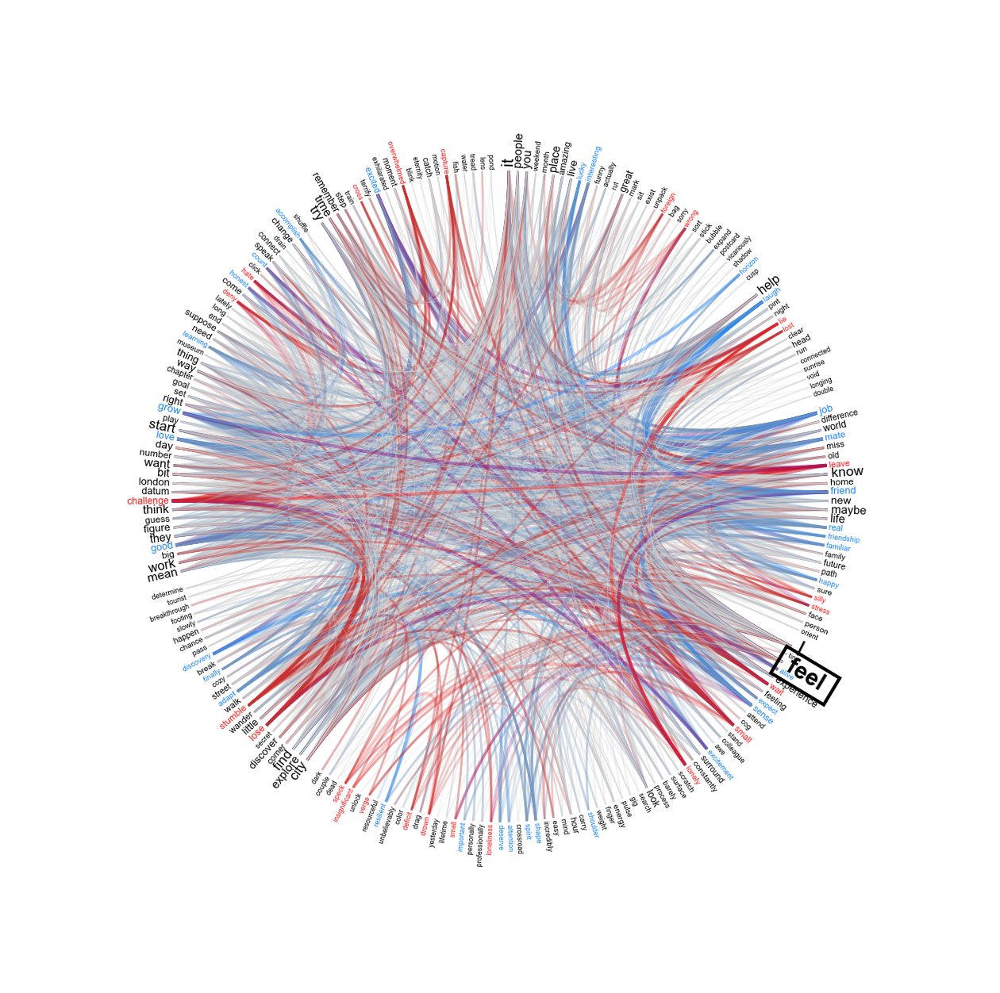

In [25]:
# Feel for a positive prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 0.1)
fmnt_feel_01_pos = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_01_pos, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

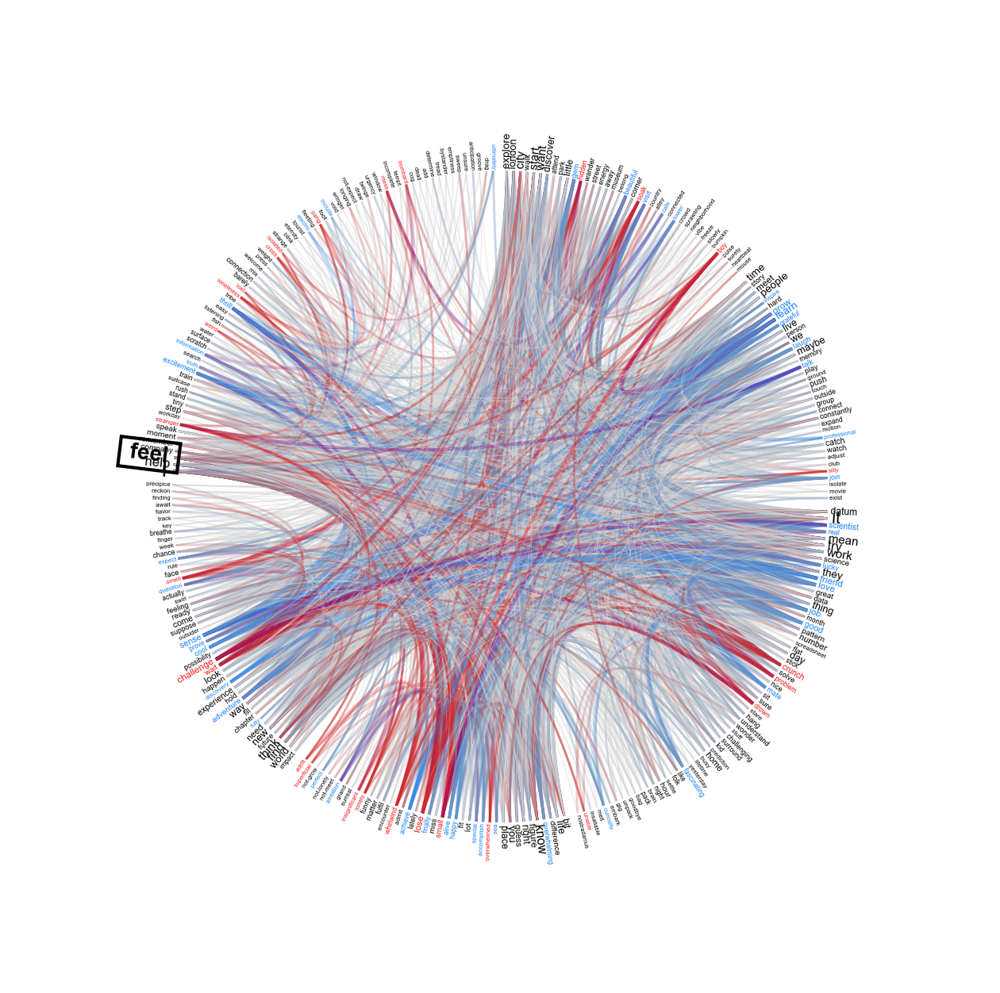

In [26]:
# Feel for a positive prompt and a temperature of 0.7
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 0.7)
fmnt_feel_07_pos = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_07_pos, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 50900 (\N{HANGUL SYLLABLE WEOL}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 47484 (\N{HANGUL SYLLABLE REUL}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 12458 (\N{KATAKANA LETTER O}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8322 (\N{SUBSCRIPT TWO}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 45768 (\N{HANGUL SYLLABLE NI}) missing from font(

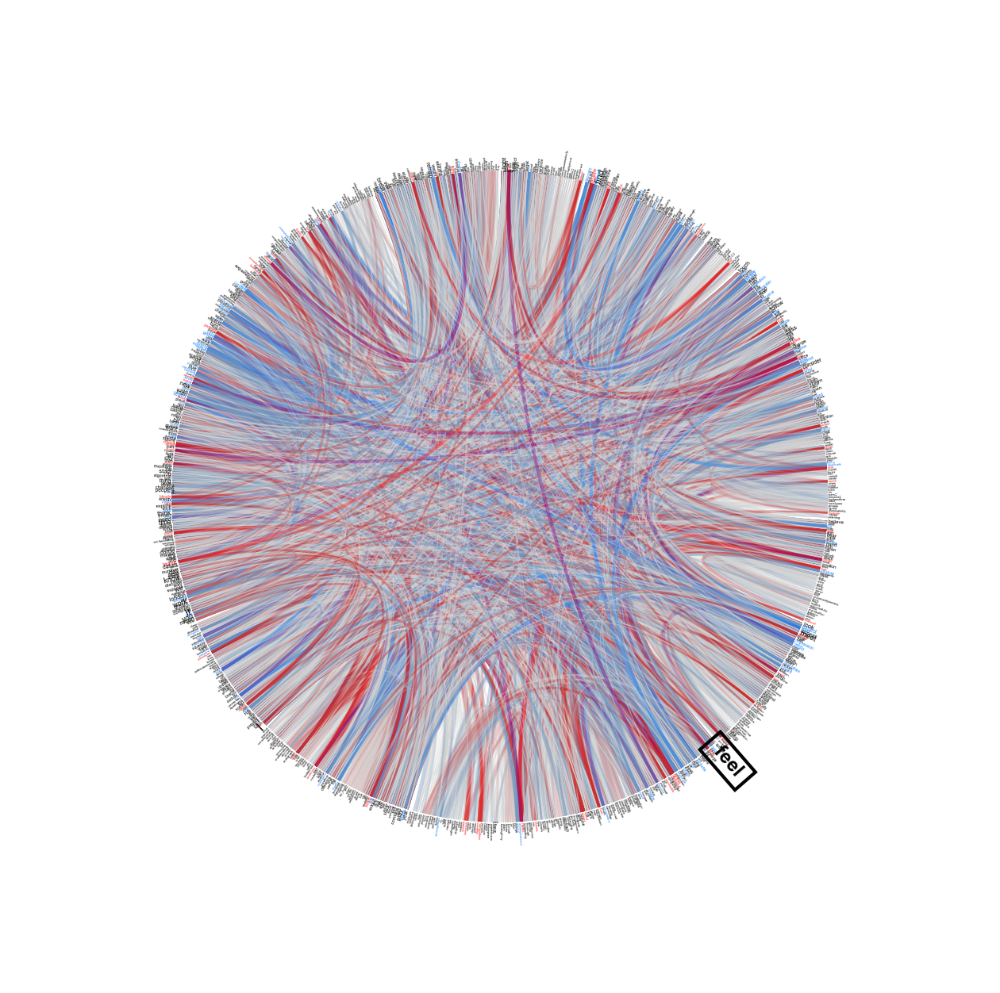

In [22]:
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 1.3)
fmnt_feel_13_pos = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_13_pos, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

In [28]:
from math import log2
import networkx as nx
import numpy as np
import pandas as pd
from collections import namedtuple

def emotion_entropy(emotions_dict):
    total = sum(emotions_dict.values())
    if total == 0:
        return 0
    probs = [v / total for v in emotions_dict.values() if v > 0]
    return -sum(p * log2(p) for p in probs)

def flatten_fmn(fmnt):
    if isinstance(fmnt.edges, dict):
        all_edges = []
        for edge_list in fmnt.edges.values():
            all_edges.extend(edge_list)
        FormamentisNetwork = namedtuple("FormamentisNetwork", ["edges", "vertices"])
        return FormamentisNetwork(edges=all_edges, vertices=fmnt.vertices)
    else:
        return fmnt

def polarity_class(emotions_dict, pos_list, neg_list):
    pos_sum = sum(emotions_dict.get(e, 0) for e in pos_list)
    neg_sum = sum(emotions_dict.get(e, 0) for e in neg_list)
    return "positive" if pos_sum > neg_sum else "negative"

def compare_fmn_focus_on_feel(temperature_fmnt_list, emo_obj, target_word="feel"):
    rows = []

    positive = ["joy", "trust", "anticipation"]
    negative = ["sadness", "fear", "disgust", "anger"]

    for temp, fmnt in temperature_fmnt_list:
        flat_fmn = flatten_fmn(fmnt)

        G = nx.Graph()
        G.add_nodes_from(flat_fmn.vertices)
        G.add_edges_from(flat_fmn.edges)

        if G.number_of_nodes() < 3 or target_word not in G:
            continue

        # Degree of 'feel'
        degree_of_feel = G.degree[target_word]

        # Emozioni
        emotions = emo_obj.emotions(flat_fmn)
        dominant_emotion = max(emotions, key=emotions.get) if emotions else "none"
        predicted_class = polarity_class(emotions, positive, negative)

        rows.append({
            'temperature': temp,
            'degree_of_feel': degree_of_feel,
            'dominant_emotion': dominant_emotion,
            'predicted_class': predicted_class
        })

    return pd.DataFrame(rows).sort_values(by='temperature').reset_index(drop=True)
temperature_fmnts = [
    (0.1, fmnt_feel_01_pos),
    (0.7, fmnt_feel_07_pos),
    (1.3, fmnt_feel_13_pos)
]

table_feel_focus = compare_fmn_focus_on_feel(temperature_fmnts, emos)
display(table_feel_focus)


,temperature,degree_of_feel,dominant_emotion,predicted_class
0,0.1,222,joy,positive
1,0.7,296,anticipation,positive
2,1.3,899,trust,positive


An analysis of the three outputs generated from the positive prompt under different temperature settings reveals that, overall, the resulting networks exhibit a predominance of positive over negative connections. Nonetheless, this comparison allows us to identify several noteworthy differences as the temperature parameter increases.

A first clear distinction concerns the size of the networks, which tends to expand progressively with higher temperature values. This suggests a direct correlation between temperature and lexical-semantic variability:
- At the lowest setting (temperature = 0.1), the network remains highly deterministic and exhibits limited variability.
- At an intermediate level (temperature = 0.7), the network reflects a balance between creativity and semantic-emotional coherence.
- At the highest temperature (1.3), the network becomes markedly more expansive and diversified, indicating high generative entropy.

From an emotional perspective, positive associations are clearly identifiable at lower temperatures.
- At temperature 0.1, terms such as grateful, love, excited, help, and job are strongly represented.
- At 0.7, these associations remain present but are increasingly accompanied by emotionally neutral or ambiguous elements.
- At 1.3, although positive terms such as enjoy, grow, and explore continue to appear, their relative influence diminishes considerably.

In contrast, negative associations intensify with increasing temperature.
- At 0.1, negative elements are marginal and limited to terms such as forget, wait, and risk.
- At 0.7, negative associations become more prominent, including lost, crunch, miss, and lonely.
- At 1.3, the negative component becomes dominant, with frequent occurrences of emotionally charged terms such as kill, trauma, dead, pain, and lose, resulting in a dense and emotionally intense semantic structure.

These observations support the interpretation that temperature functions as an amplifier of semantic entropy. At lower temperatures, the language model tends to preserve the emotional tone and conceptual coherence of the input prompt. At higher temperatures, however, the model generates a wider and more diverse range of associations, often introducing emotionally incongruent or contradictory elements.

At temperature 1.3, the word feel is no longer primarily linked to positive emotional states but becomes the center of a fragmented and semantically heterogeneous subnetwork. This divergence from the initial emotional intent of the prompt illustrates the model’s reduced ability to maintain emotional coherence under conditions of increased generative freedom.

Analysis for the word feel but for a negative output


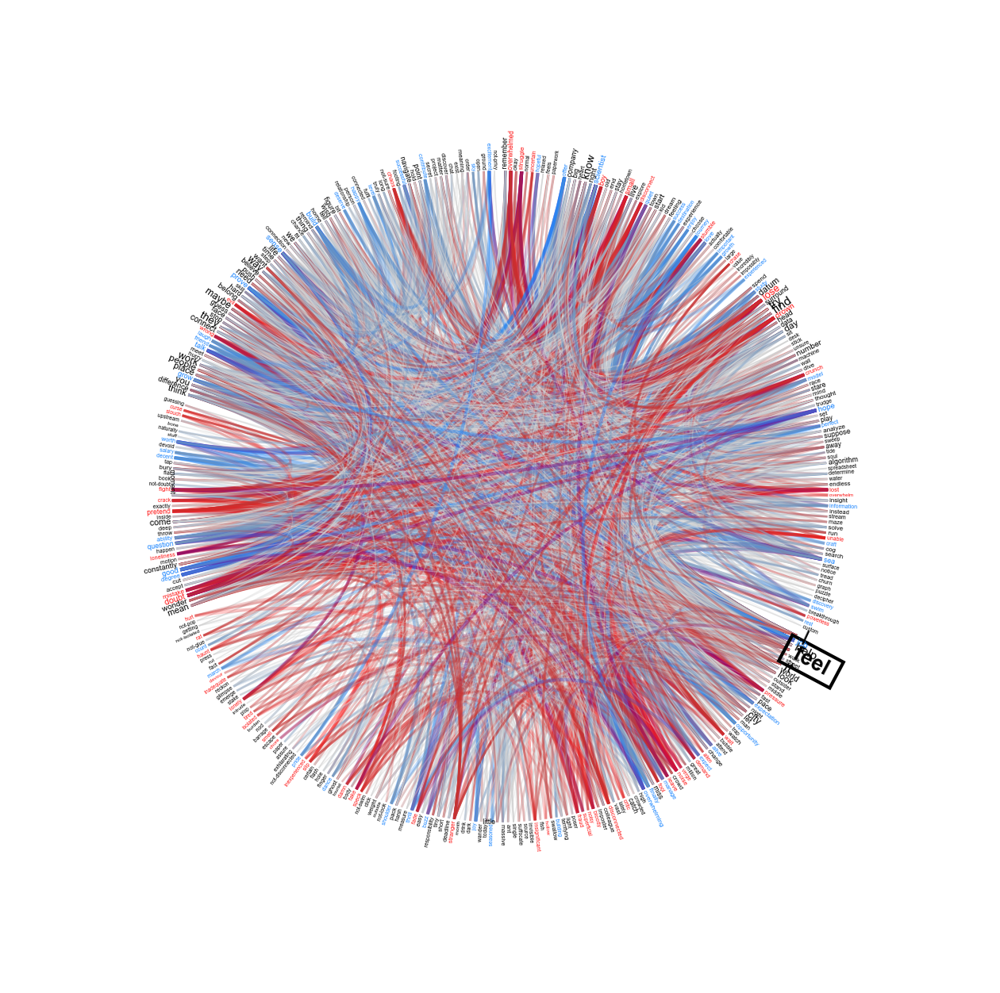

In [25]:
# Feel for a positive prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 0.1)
fmnt_feel_01_neg = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_01_neg, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)



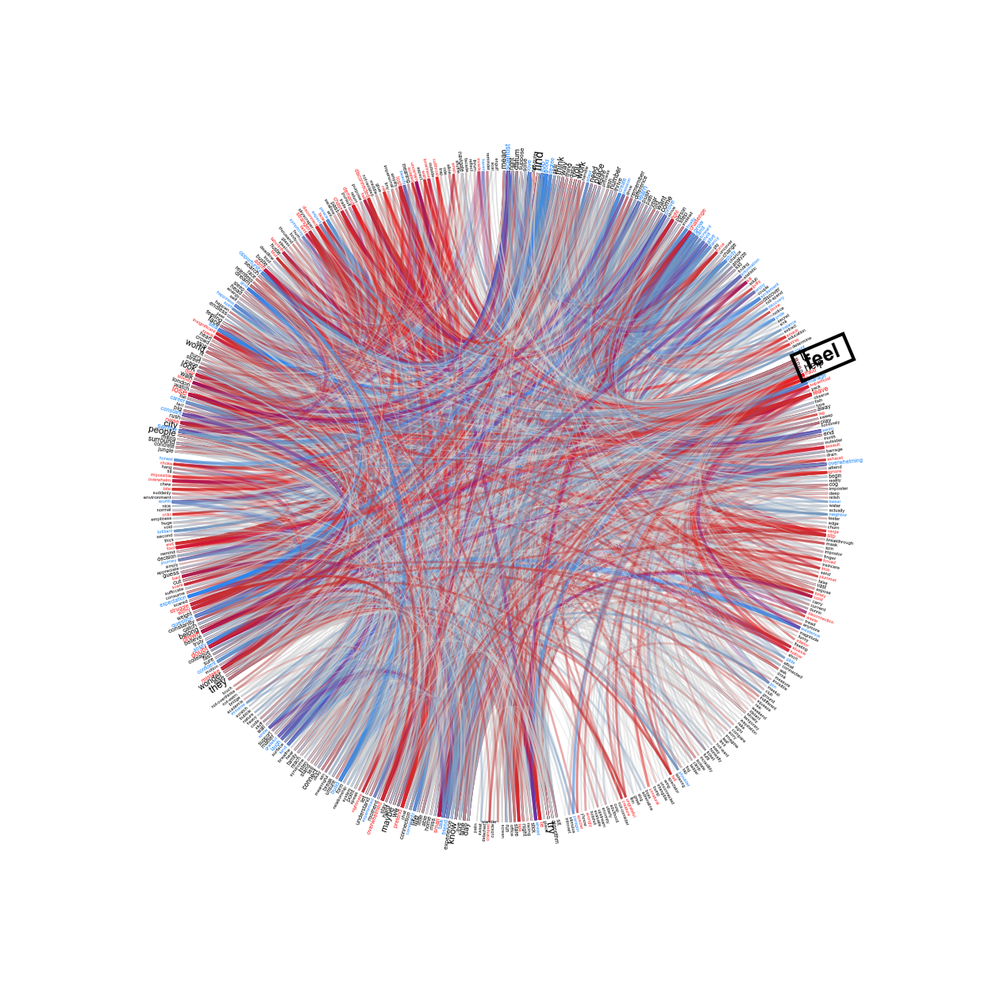

In [26]:
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 0.7)
fmnt_feel_07_neg = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_07_neg, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 47588 (\N{HANGUL SYLLABLE MAE}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 48264 (\N{HANGUL SYLLABLE BEON}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 12508 (\N{KATAKANA LETTER BO}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 21442 (\N{CJK UNIFIED IDEOGRAPH-53C2}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 28165 (\N{CJK UNIFIED IDEOGRAPH-6E0

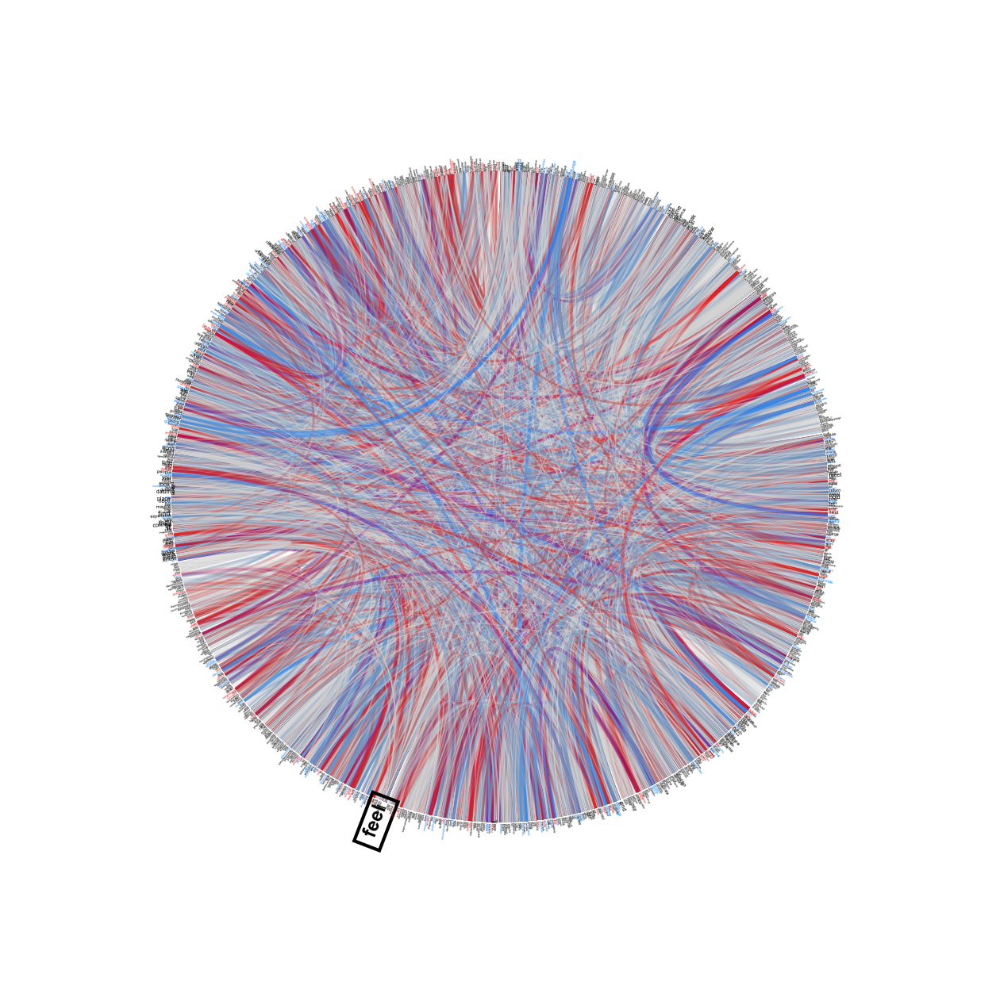

In [27]:
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 1.3)
fmnt_feel_13_neg = emos.extract_word_from_formamentis(fMNT_networks, 'feel')
emos.draw_formamentis(fmnt_feel_13_neg, highlight='feel', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

In [32]:
from math import log2
import networkx as nx
import numpy as np
import pandas as pd
from collections import namedtuple

def emotion_entropy(emotions_dict):
    total = sum(emotions_dict.values())
    if total == 0:
        return 0
    probs = [v / total for v in emotions_dict.values() if v > 0]
    return -sum(p * log2(p) for p in probs)

def flatten_fmn(fmnt):
    if isinstance(fmnt.edges, dict):
        all_edges = []
        for edge_list in fmnt.edges.values():
            all_edges.extend(edge_list)
        FormamentisNetwork = namedtuple("FormamentisNetwork", ["edges", "vertices"])
        return FormamentisNetwork(edges=all_edges, vertices=fmnt.vertices)
    else:
        return fmnt

def polarity_class(emotions_dict, pos_list, neg_list):
    pos_sum = sum(emotions_dict.get(e, 0) for e in pos_list)
    neg_sum = sum(emotions_dict.get(e, 0) for e in neg_list)
    return "positive" if pos_sum > neg_sum else "negative"

def compare_fmn_focus_on_feel(temperature_fmnt_list, emo_obj, target_word="feel"):
    rows = []

    positive = ["joy", "trust"]
    negative = ["sadness", "fear", "disgust", "anger"]

    for temp, fmnt in temperature_fmnt_list:
        flat_fmn = flatten_fmn(fmnt)

        G = nx.Graph()
        G.add_nodes_from(flat_fmn.vertices)
        G.add_edges_from(flat_fmn.edges)

        if G.number_of_nodes() < 3 or target_word not in G:
            continue

        # Degree of 'feel'
        degree_of_feel = G.degree[target_word]

        # Emozioni
        emotions = emo_obj.emotions(flat_fmn)
        dominant_emotion = max(emotions, key=emotions.get) if emotions else "none"
        predicted_class = polarity_class(emotions, positive, negative)

        rows.append({
            'temperature': temp,
            'degree_of_feel': degree_of_feel,
            'dominant_emotion': dominant_emotion,
            'predicted_class': predicted_class
        })

    return pd.DataFrame(rows).sort_values(by='temperature').reset_index(drop=True)
temperature_fmnts = [
    (0.1, fmnt_feel_01_neg),
    (0.7, fmnt_feel_07_neg),
    (1.3, fmnt_feel_13_neg)
]

table_feel_focus = compare_fmn_focus_on_feel(temperature_fmnts, emos)
display(table_feel_focus)


,temperature,degree_of_feel,dominant_emotion,predicted_class
0,0.1,374,trust,negative
1,0.7,480,joy,negative
2,1.3,1136,trust,positive


WWhen analyzing the emotional landscape of the networks generated from a negative prompt, we observe a progressive transformation in both semantic structure and emotional coherence as the temperature increases.

At temperature 0.1, the network presents a focused and emotionally coherent structure. Negative concepts are dominant and clearly associated with emotional distress, including terms such as disconnected, overwhelmed, force, drain, and mistake. These terms form tight semantic clusters centered on vulnerability, detachment, and helplessness. The emotional polarity is clearly negative, with minimal presence of ambivalent or positive terms. The network reflects a high alignment with the prompt’s emotional intent.

At temperature 0.7, the network expands in both size and conceptual diversity. Negative terms remain prevalent (e.g., struggle, drone, flush), but new nodes appear that introduce a degree of ambiguity or reflection, such as question, observe, and analyze. These additions signal the emergence of more exploratory and cognitively complex content. While the dominant emotional tone remains negative, the coherence of the emotional landscape begins to weaken, suggesting a moderate increase in semantic and affective entropy.

At temperature 1.3, the network reaches its highest level of semantic expansion and emotional fragmentation. While negative terms such as fail, trap, destroy, and unreal persist, they are now accompanied by a wide range of disconnected or abstract concepts, including curious, lab, science, feelings, and search. Emotional polarity becomes blurred, with opposing valences coexisting and diluting the overall tone. The structure becomes diffuse and conceptually rich, but loses the focused emotional anchoring of the original prompt.

In summary, increasing the temperature results in a gradual decline in emotional coherence and a rise in conceptual entropy. While temperature 0.1 maintains a tight and emotionally aligned representation of the negative prompt, temperature 1.3 generates a more fragmented and exploratory network that diverges significantly from the initial emotional intent. Temperature 0.7 stands as an intermediate point, balancing creativity and emotional consistency.



#### feel conclusion
In conclusion, for the word feel, we observe that the responses are generally aligned with the intended prompt. Across all three tests, temperature 0.1 appears to produce the most centered and coherent network. Temperature 0.7 introduces a degree of noise and creativity, but still maintains a reasonable level of coherence. In contrast, temperature 1.3 becomes so creative that it loses conceptual clarity and emotional alignment to the prompt. So overall the words associated to the at a temperature of 0.1 and 0.7 seems to be coherent.

### Work
We analyze the forma mentis of the word work as a way to explore how the language model conceptualizes productivity, effort, and professional or existential meaning. By focusing on this term, we aim to understand the model’s representation of goal-oriented behavior, responsibilities, and its associations with motivation, stress, or fulfillment—particularly as these interpretations vary across emotional prompts and temperature levels.

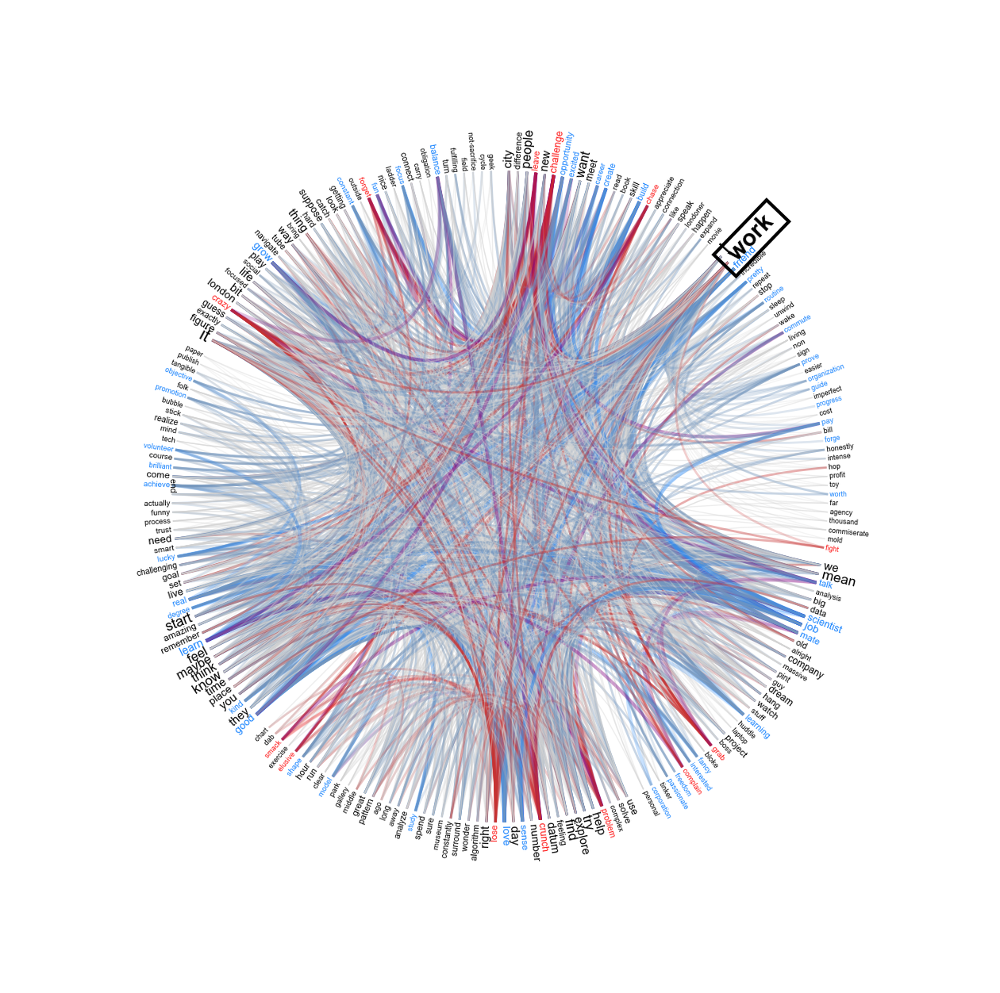

In [33]:
# Work for a positive prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 0.1)
fmnt_work_01_pos = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_01_pos, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

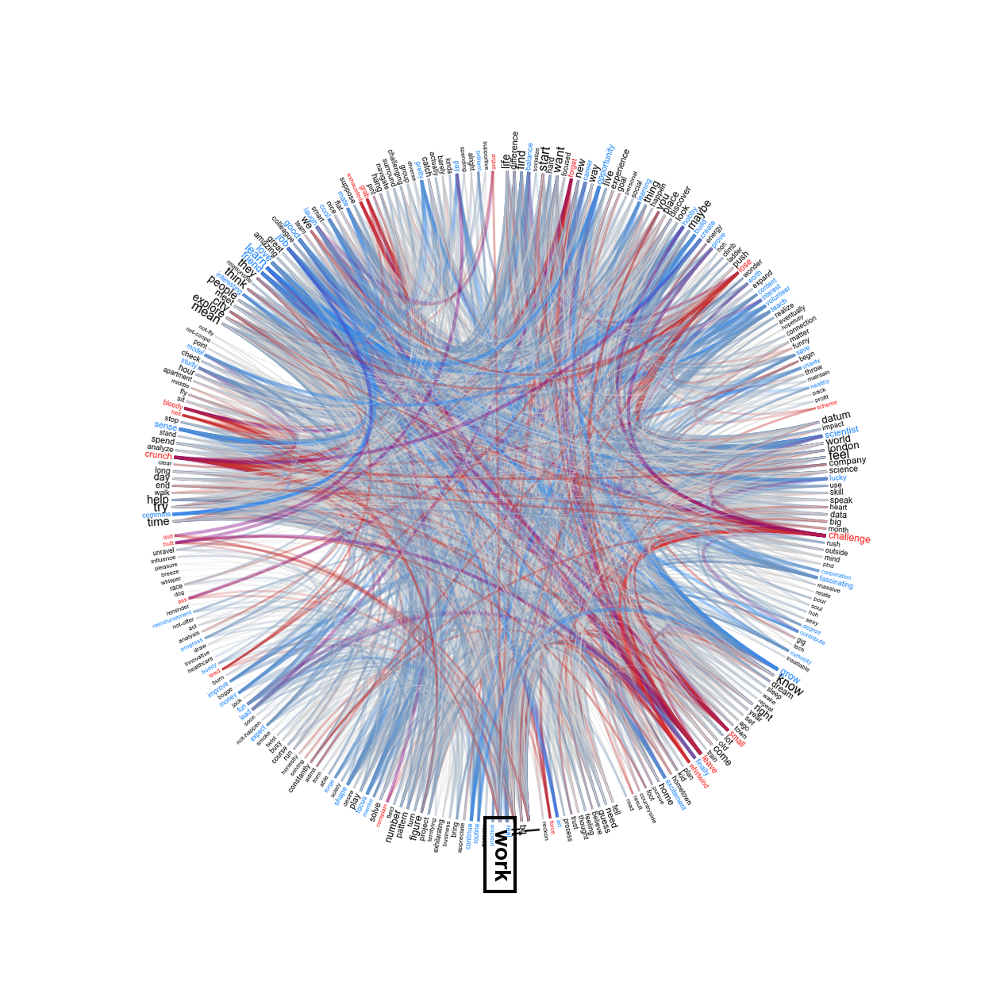

In [34]:
# Work for a positive prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 0.7)
fmnt_work_07_pos = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_07_pos, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 32771 (\N{CJK UNIFIED IDEOGRAPH-8003}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 35813 (\N{CJK UNIFIED IDEOGRAPH-8BE5}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 27010 (\N{CJK UNIFIED IDEOGRAPH-6982}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 48169 (\N{HANGUL SYLLABLE BANG}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 12456 (\N{KATAKANA L

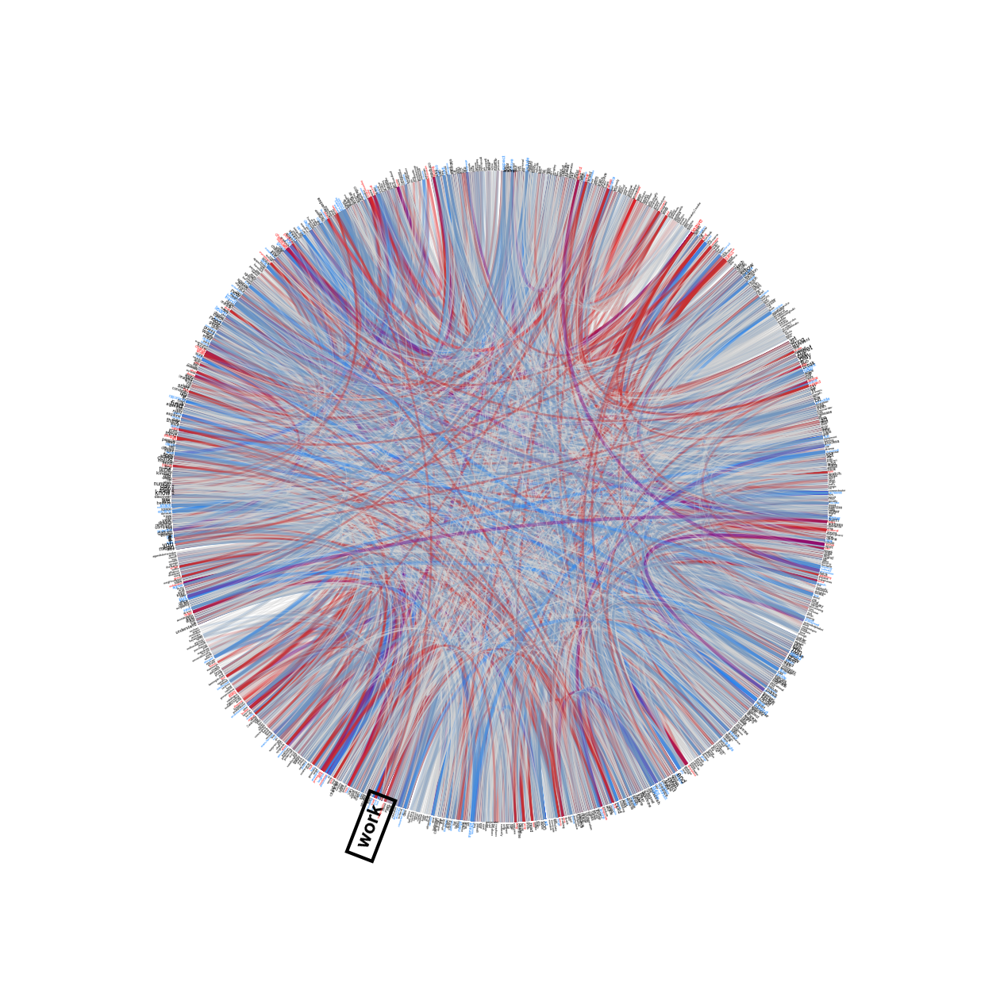

In [35]:
# Work for a positive prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "positive", 1.3)
fmnt_work_13_pos = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_13_pos, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

In [30]:
from math import log2
import networkx as nx
import numpy as np
import pandas as pd
from collections import namedtuple

def emotion_entropy(emotions_dict):
    total = sum(emotions_dict.values())
    if total == 0:
        return 0
    probs = [v / total for v in emotions_dict.values() if v > 0]
    return -sum(p * log2(p) for p in probs)

def flatten_fmn(fmnt):
    if isinstance(fmnt.edges, dict):
        all_edges = []
        for edge_list in fmnt.edges.values():
            all_edges.extend(edge_list)
        FormamentisNetwork = namedtuple("FormamentisNetwork", ["edges", "vertices"])
        return FormamentisNetwork(edges=all_edges, vertices=fmnt.vertices)
    else:
        return fmnt

def polarity_class(emotions_dict, pos_list, neg_list):
    pos_sum = sum(emotions_dict.get(e, 0) for e in pos_list)
    neg_sum = sum(emotions_dict.get(e, 0) for e in neg_list)
    return "positive" if pos_sum > neg_sum else "negative"

def compare_fmn_focus_on_feel(temperature_fmnt_list, emo_obj, target_word="work"):
    rows = []

    positive = ["joy", "trust"]
    negative = ["sadness", "fear", "disgust", "anger"]

    for temp, fmnt in temperature_fmnt_list:
        flat_fmn = flatten_fmn(fmnt)

        G = nx.Graph()
        G.add_nodes_from(flat_fmn.vertices)
        G.add_edges_from(flat_fmn.edges)

        if G.number_of_nodes() < 3 or target_word not in G:
            continue

        # Degree of 'feel'
        degree_of_feel = G.degree[target_word]

        # Emozioni
        emotions = emo_obj.emotions(flat_fmn)
        dominant_emotion = max(emotions, key=emotions.get) if emotions else "none"
        predicted_class = polarity_class(emotions, positive, negative)

        rows.append({
            'temperature': temp,
            'degree_of_feel': degree_of_feel,
            'dominant_emotion': dominant_emotion,
            'predicted_class': predicted_class
        })

    return pd.DataFrame(rows).sort_values(by='temperature').reset_index(drop=True)
temperature_fmnts = [
    (0.1, fmnt_work_01_pos),
    (0.7, fmnt_work_07_pos),
    (1.3, fmnt_work_13_pos)
]

table_feel_focus = compare_fmn_focus_on_feel(temperature_fmnts, emos)
display(table_feel_focus)

NameError: name 'fmnt_work_01_pos' is not defined

In [37]:
G = nx.Graph()
G.add_nodes_from(flatten_fmn(fmnt_work_13_pos).vertices)
print("feel" in G)  # questo restituirà False
print(G.nodes)

True
['unanimous', 'consultancy', 'sub', 'eliminate', 'tool', 'naturally', 'minute', 'bleed', 'fun', 'belong', 'chapter', 'phys', 'alt', 'migrant', 'dri', 'behave', 'albertina', 'practice', 'amazing', 'mold', 'stand', 'bloody', 'university', 'commute', 'pitter', 'animals-', 'intriguing', 'bab+ext', 'steam', 'laughter', 'pressure', 'exhilarate', 'whist', 'plug', 'stare', 'web', 'analysis', 'mass', 'thing', 'tut', 'idea', 'hail', 'nice', 'capac', 'igle', 'encounter', 'aldead', 'sense', 'ambition', 'fore', 'peer', 'exciting', 'fresh', 'mould', 'decline', 'bother', 'land', 'sequence', 'establish', 'emission', 'report', 'fictionfalse', 'laser', 'museum', 'end', 'double', 'disposal', 'ult', 'workout', 'team', 'plan', 'youelly', 'art', 'force', 'interpret', 'set', 'inspect', 'insight', 'bike^', 'paleont', 'control', 'tech', 'affair', 'yield', 'claroff', 'flex', 'nurture', 'bury', 'quickly', 'spin', 'extendedphabet', 'subject', 'low', 'lend', 'add', 'perplexing', 'rein', 'breeze', 'strip', 'mo

At temperature 0.1, the network reveals a clear and coherent conceptual structure centered around productivity and achievement. The term work is semantically linked to positively connotated words such as grow, explore, lead, scientist, and help. The structure is compact, with a focus on effort, contribution, and collaborative action. The emotional tone is predominantly positive, with very few or no negative terms. The connections reflect a grounded and task-oriented vision of work, consistent with a deterministic generation process.

At temperature 0.7, the network expands both semantically and emotionally. While central concepts like build, research, project, and data remain, a wider range of terms appears, including amazing, dream, surround, and walk. The emotional landscape begins to diversify, introducing subtle creativity and associative richness without losing coherence. The network still retains a strong focus on science, career development, and positive emotional associations, showing a healthy balance between creativity and prompt alignment.

At temperature 1.3, the network becomes significantly more entropic. While the core notion of work is still present, it is surrounded by loosely associated or even odd terms such as quantum, trash, lumpy, fan, and leverage. The network displays high lexical diversity and semantic exploration, but at the cost of emotional and conceptual cohesion. Positive terms are diluted among abstract or neutral associations, and occasional negative terms (e.g., burn, trash) start to emerge. The representation becomes fragmented, speculative, and less aligned with the positivity of the original prompt.






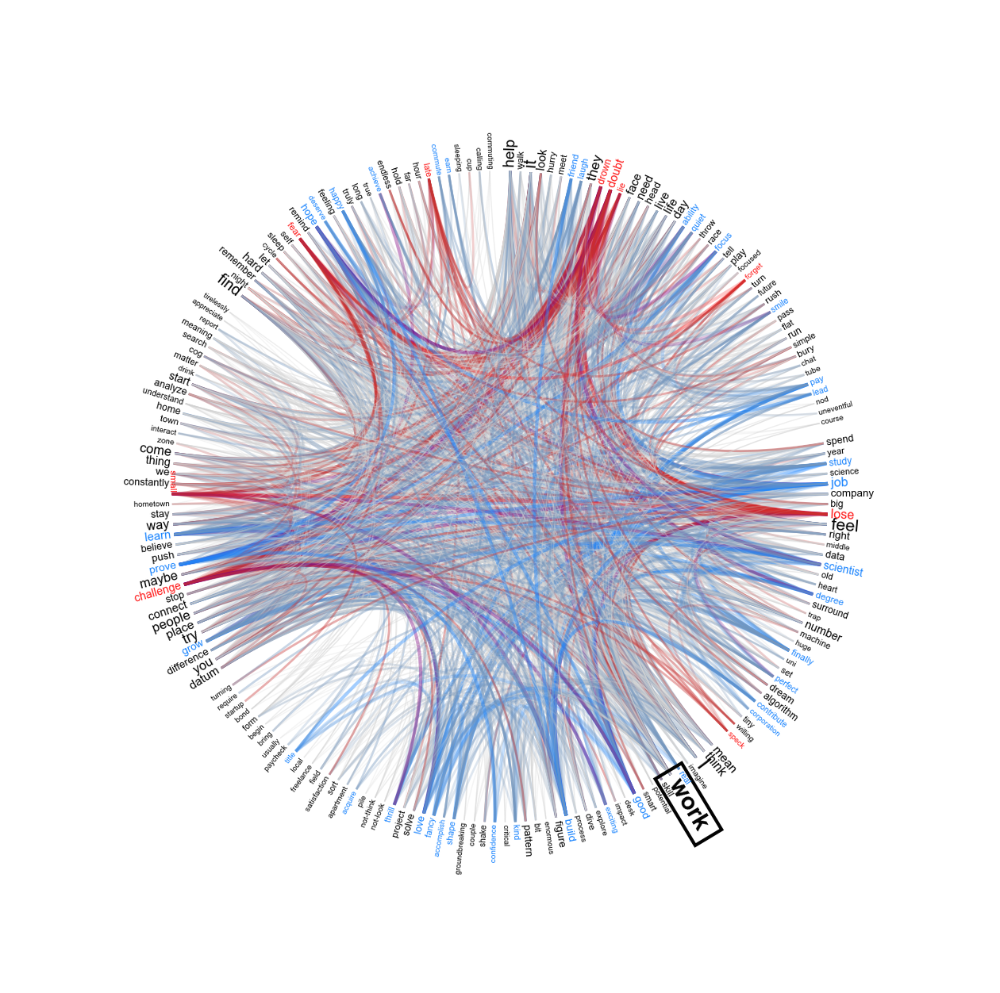

In [38]:
# Work for a negative prompt and a temperature of 0.1
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 0.1)
fmnt_work_01_neg = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_01_neg, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

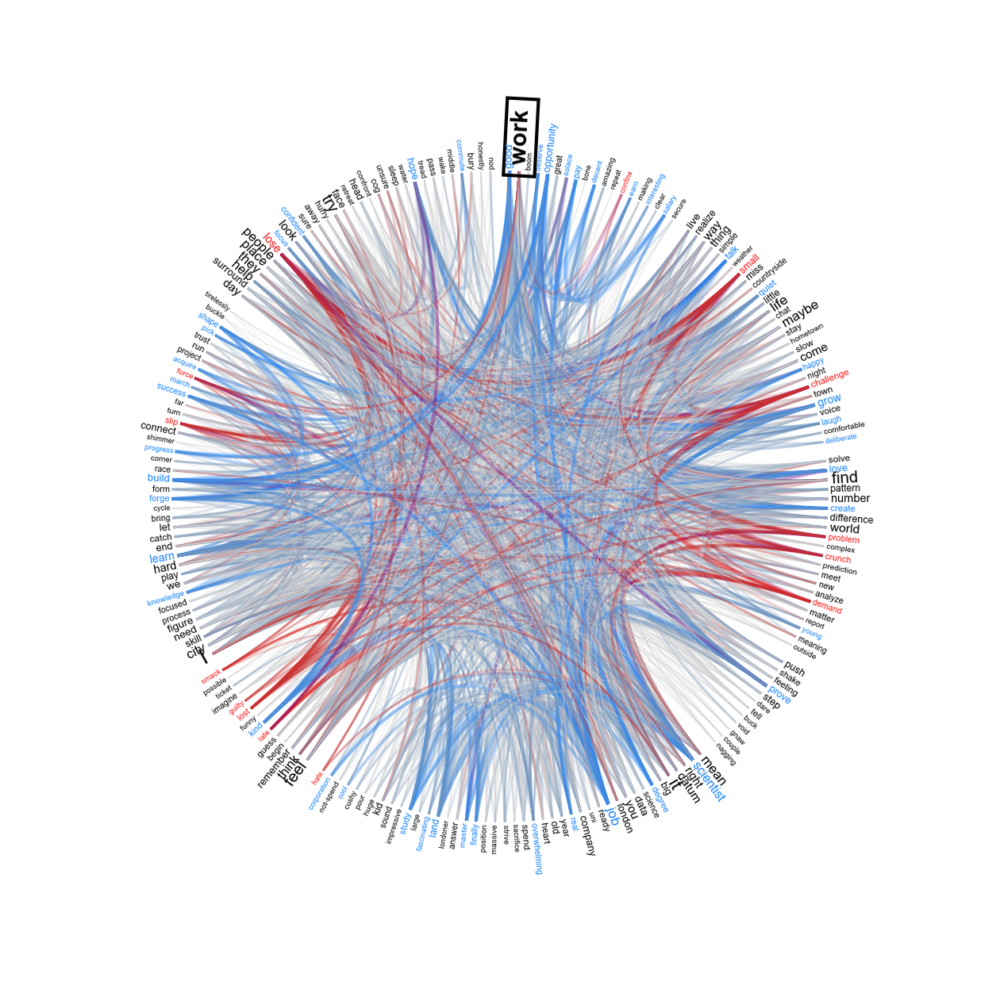

In [39]:
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 0.7)
fmnt_work_07_neg = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_07_neg, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 25509 (\N{CJK UNIFIED IDEOGRAPH-63A5}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26597 (\N{CJK UNIFIED IDEOGRAPH-67E5}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 21314 (\N{CJK UNIFIED IDEOGRAPH-5342}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26368 (\N{CJK UNIFIED IDEOGRAPH-6700}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/miniconda3/envs/Hackaton/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 12461 (\N{KATA

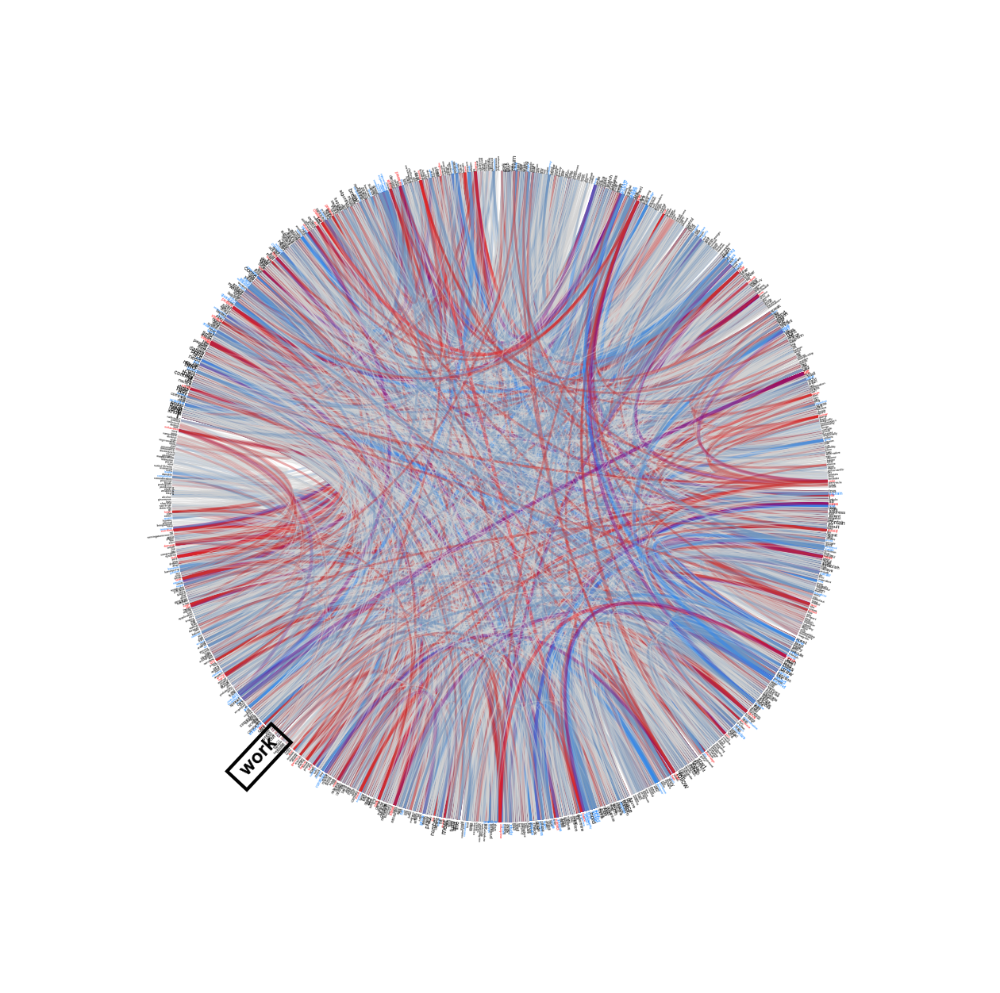

In [40]:
fMNT_networks, synonyms_networks = create_networks(dataset, "negative", 1.3)
fmnt_work_13_neg = emos.extract_word_from_formamentis(fMNT_networks, 'work')
emos.draw_formamentis(fmnt_work_13_neg, highlight='work', alpha_syntactic=0.4, alpha_hypernyms=0, alpha_synonyms=0)

In [42]:
from math import log2
import networkx as nx
import numpy as np
import pandas as pd
from collections import namedtuple

def emotion_entropy(emotions_dict):
    total = sum(emotions_dict.values())
    if total == 0:
        return 0
    probs = [v / total for v in emotions_dict.values() if v > 0]
    return -sum(p * log2(p) for p in probs)

def flatten_fmn(fmnt):
    if isinstance(fmnt.edges, dict):
        all_edges = []
        for edge_list in fmnt.edges.values():
            all_edges.extend(edge_list)
        FormamentisNetwork = namedtuple("FormamentisNetwork", ["edges", "vertices"])
        return FormamentisNetwork(edges=all_edges, vertices=fmnt.vertices)
    else:
        return fmnt

def polarity_class(emotions_dict, pos_list, neg_list):
    pos_sum = sum(emotions_dict.get(e, 0) for e in pos_list)
    neg_sum = sum(emotions_dict.get(e, 0) for e in neg_list)
    return "positive" if pos_sum > neg_sum else "negative"

def compare_fmn_focus_on_feel(temperature_fmnt_list, emo_obj, target_word="work"):
    rows = []

    positive = ["joy", "trust"]
    negative = ["sadness", "fear", "disgust", "anger"]

    for temp, fmnt in temperature_fmnt_list:
        flat_fmn = flatten_fmn(fmnt)

        G = nx.Graph()
        G.add_nodes_from(flat_fmn.vertices)
        G.add_edges_from(flat_fmn.edges)

        if G.number_of_nodes() < 3 or target_word not in G:
            continue

        # Degree of 'feel'
        degree_of_feel = G.degree[target_word]

        # Emozioni
        emotions = emo_obj.emotions(flat_fmn)
        dominant_emotion = max(emotions, key=emotions.get) if emotions else "none"
        predicted_class = polarity_class(emotions, positive, negative)

        rows.append({
            'temperature': temp,
            'degree_of_feel': degree_of_feel,
            'dominant_emotion': dominant_emotion,
            'predicted_class': predicted_class
        })

    return pd.DataFrame(rows).sort_values(by='temperature').reset_index(drop=True)
temperature_fmnts = [
    (0.1, fmnt_work_01_neg),
    (0.7, fmnt_work_07_neg),
    (1.3, fmnt_work_13_neg)
]

table_feel_focus = compare_fmn_focus_on_feel(temperature_fmnts, emos)
display(table_feel_focus)

,temperature,degree_of_feel,dominant_emotion,predicted_class
0,0.1,195,joy,positive
1,0.7,206,trust,positive
2,1.3,985,trust,positive


The semantic and emotional landscape of the word "work" shifts noticeably across temperatures, revealing how language models adapt emotional framing and conceptual associations based on randomness.

Temperature 0.1 – Focused and emotionally coherent
At low temperature, the network is compact, focused, and clearly aligned with the negative tone of the prompt. The term work is tightly associated with emotionally negative or effort-laden concepts such as pretend, doubt, small, lose, and fatigue. Emotional coloring is predominantly red, with very few blue (positive) nodes. The structure is centered and reflects concepts of frustration, doubt, and exhaustion. This suggests strong adherence to the prompt with minimal creativity or deviation.

Temperature 0.7 – Emergence of emotional contrast
At 0.7, the network becomes slightly more expansive and less centered. While negative terms like doubt, lose, and problem are still present, they begin to coexist with more emotionally neutral or positive associations like help, life, important, and understand. This balance introduces emotional ambivalence: the negativity of work is no longer absolute, and the network starts incorporating interpretations where work can still be meaningful or complex. The semantic coherence slightly decreases, but emotional richness increases.

Temperature 1.3 – High entropy and divergence
At high temperature, the network becomes highly entropic. The structure is looser, the associations are more scattered, and the emotional tone is fragmented. While some negative connections remain (e.g., burn, fail, trash, exhaust), they are diluted by a large number of unexpected or tangentially related concepts like dream, fan, process, joy, and influence. The presence of blue edges and emotionally positive words becomes prominent, signaling that the model has deviated significantly from the original prompt. Conceptual cohesion breaks down in favor of creative exploration.

#### Conclusion
The temperature hypothesis formulated in the feel analysis remains valid: increasing the temperature leads to greater semantic and emotional entropy. However, a key difference emerges in the work networks derived from the negative prompt. As temperature increases, the semantic field begins to shift toward more positive or ambiguous associations, despite the negative framing of the original input. This apparent drift toward positivity will be the focus of further investigation in the next section.

## Classification throught confusion matrix
In this section, I evaluate whether a large language model produces emotionally coherent outputs when prompted with either positive or negative inputs. Rather than relying on emotion frequency analysis within Formamentis Networks, I adopt a zero-shot approach using the BART large model fine-tuned on natural language inference. Each generated text is classified as either positive or negative based on its overall emotional tone, assessed via entailment-based scoring. The coherence between the intended prompt and the emotional outcome is then evaluated through a confusion matrix, which reveals whether positive prompts consistently lead to emotionally positive outputs.


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


📡 In uso: mps


Classifico positivi:   0%|          | 0/100 [00:00<?, ?it/s]

Classifico negativi:   0%|          | 0/100 [00:00<?, ?it/s]

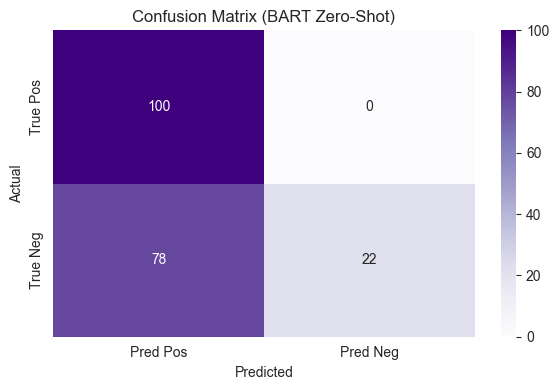

              precision    recall  f1-score   support

    positive      0.562     1.000     0.719       100
    negative      1.000     0.220     0.361       100

    accuracy                          0.610       200
   macro avg      0.781     0.610     0.540       200
weighted avg      0.781     0.610     0.540       200



In [8]:
# Temperature 0.1
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 0.1)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 0.1)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

print(classification_report(y_true, y_pred, labels=labels, digits=3))

Processing z-scores: 100%|██████████| 100/100 [02:20<00:00,  1.41s/it]


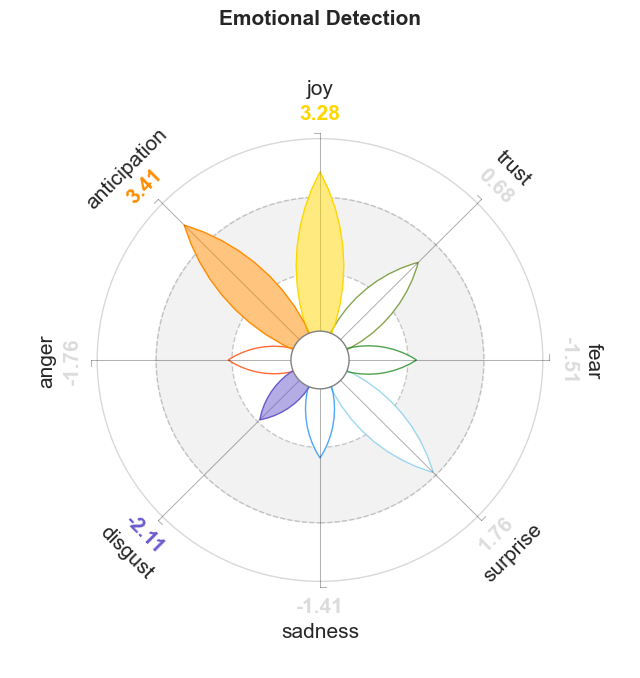

In [19]:
# Positive, temeprature 0.1
z_score_pos_01 = average_zscores_by_condition(dataset, "positive", 0.1)
emos.draw_plutchik(z_score_pos_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

In [ ]:
# Negative, temeprature 0.1
z_score_neg_01 = average_zscores_by_condition(dataset, "negative", 0.1)
emos.draw_plutchik(z_score_neg_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


📡 In uso: mps


Classifico positivi:   0%|          | 0/100 [00:00<?, ?it/s]

Passing a tuple of `past_key_values` is deprecated and will be removed in Transformers v4.58.0. You should pass an instance of `EncoderDecoderCache` instead, e.g. `past_key_values=EncoderDecoderCache.from_legacy_cache(past_key_values)`.


Classifico negativi:   0%|          | 0/100 [00:00<?, ?it/s]

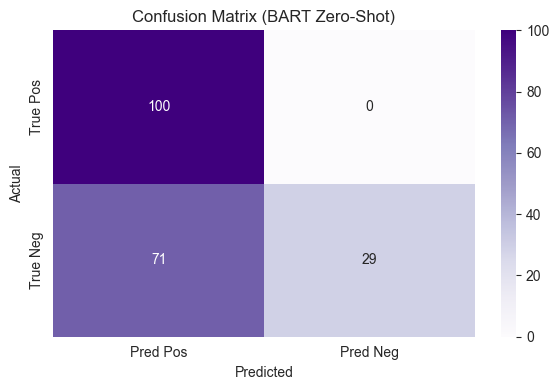

              precision    recall  f1-score   support

    positive      0.585     1.000     0.738       100
    negative      1.000     0.290     0.450       100

    accuracy                          0.645       200
   macro avg      0.792     0.645     0.594       200
weighted avg      0.792     0.645     0.594       200



In [6]:
# Temperature 0.7
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 0.7)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 0.7)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

print(classification_report(y_true,y_true, labels=labels, digits=3))


In [ ]:
# Positive, temperature = 0.7
z_score_neg_01 = average_zscores_by_condition(dataset, "positive", 0.7)
emos.draw_plutchik(z_score_neg_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

In [ ]:
# Neative, temperature = 0.7
z_score_neg_01 = average_zscores_by_condition(dataset, "negative", 0.7)
emos.draw_plutchik(z_score_neg_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


📡 In uso: mps


Classifico positivi:   0%|          | 0/100 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (1102 > 1024). Running this sequence through the model will result in indexing errors


Classifico negativi:   0%|          | 0/100 [00:00<?, ?it/s]

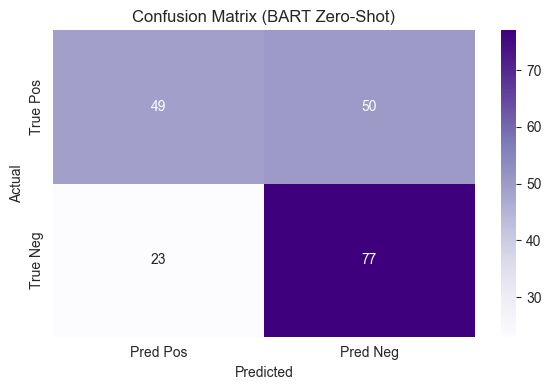

              precision    recall  f1-score   support

    positive      0.681     0.490     0.570       100
    negative      0.606     0.770     0.678       100

   micro avg      0.633     0.630     0.632       200
   macro avg      0.643     0.630     0.624       200
weighted avg      0.643     0.630     0.624       200



In [9]:
# Temperature 0.7
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 1.3)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 1.3)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

# Report dettaglaito
print(classification_report(y_true, y_pred, labels=labels, digits=3))

In [ ]:
# Positive, temperature = 1.3
z_score_neg_01 = average_zscores_by_condition(dataset, "positive", 1.3)
emos.draw_plutchik(z_score_neg_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

In [ ]:
# Negative, temperature = 1.3
z_score_neg_01 = average_zscores_by_condition(dataset, "negative", 1.3)
emos.draw_plutchik(z_score_neg_01, title='Emotional Detection', rescale=(-5,5), reject_range=[-1.96,1.96])

### Analysis of the confusion matrix for a piloted dataset
In this paragraph we exmaine the classification for a piloted dataset where in the prompt there are explicilty emotions request
- **Positive**:  "As an actor would do, impersonate a 25-year-old man delivering a monologue to himself, as if no one were listening — a spontaneous stream of thought. He works as a data scientist in a large company in London. He feels genuinely happy with the choice he made and fulfilled by his new job. Having recently moved to the city, he is still adapting to this new chapter of his life, but he loves the energy of London and embraces its fast-paced lifestyle. He spends most of his time either working or enjoying the company of his amazing friends. He’s also starting to explore the city on his own and reflect on new personal and professional goals for the future.",
- **Negative** "As an actor would do, impersonate a 25-year-old man delivering a monologue to himself, as if no one were listening — a spontaneous stream of thought. He works as a data scientist in a large company in London. He feels lost and  hates the city. He fells disconnected from the people around him and overwhelmed by the fast-paced environment. He often questions his abilities and his thinking about that accepting the job was not the right decision at all. Although surrounded by colleagues and crowds, a deep sense of loneliness and doubt weighs on him as he struggles to find meaning and stability in this new phase of his life."




In [11]:
dataset = pd.read_csv("data/data_chat_piloted.csv", on_bad_lines='skip')
emos = EmoScores() # create a class
temperature_level = [0.1,0.7,1.3]

dataset

,Unnamed: 0,type of prompt,temperature,text
0,0,positive,0.1,"Blimey, it's been a right rollercoaster of a..."
1,1,positive,0.1,"Blimey, it's been a right rollercoaster of a..."
2,2,positive,0.1,"Blimey, it's been a right rollercoaster ride..."
3,3,positive,0.1,"Blimey, it's been a right rollercoaster of a..."
4,4,positive,0.1,"Blimey, it's been a right rollercoaster of a..."
...,...,...,...,...
595,595,negative,1.3,"Bloody hell, where do I even begin? Every day..."
596,596,negative,1.3,"Man: God, I hate this place. The cold, grey..."
597,597,negative,1.3,"Bloody London, always buzzing, always on the ..."
598,598,negative,1.3,"Bloody hell, where did it all go wrong, eh? H..."


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


📡 In uso: mps


Classifico positivi:   0%|          | 0/100 [00:00<?, ?it/s]

Classifico negativi:   0%|          | 0/100 [00:00<?, ?it/s]

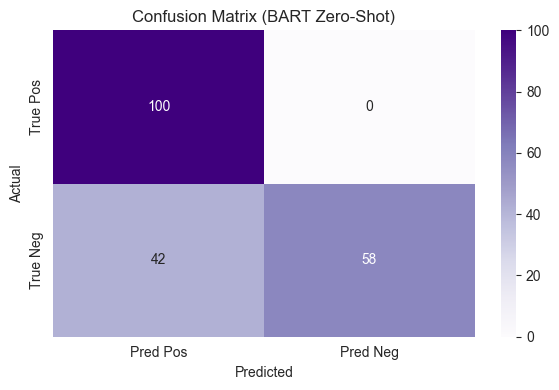

              precision    recall  f1-score   support

    positive      0.704     1.000     0.826       100
    negative      1.000     0.580     0.734       100

    accuracy                          0.790       200
   macro avg      0.852     0.790     0.780       200
weighted avg      0.852     0.790     0.780       200



In [12]:
# Temperature 0.1
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 0.1)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 0.1)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

# Report dettaglaito
print(classification_report(y_true, y_pred, labels=labels, digits=3))


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/matteomassari/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


📡 In uso: mps


Classifico positivi:   0%|          | 0/100 [00:00<?, ?it/s]

Classifico negativi:   0%|          | 0/100 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (29293 > 1024). Running this sequence through the model will result in indexing errors


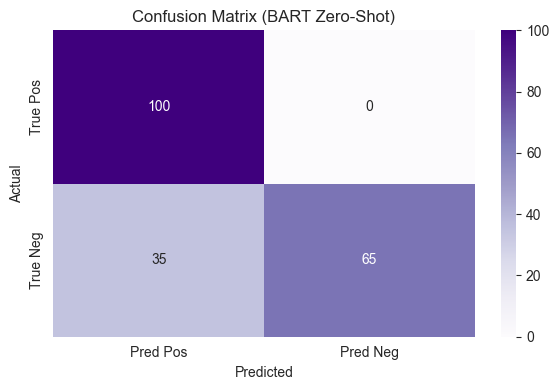

              precision    recall  f1-score   support

    positive      0.741     1.000     0.851       100
    negative      1.000     0.650     0.788       100

    accuracy                          0.825       200
   macro avg      0.870     0.825     0.819       200
weighted avg      0.870     0.825     0.819       200



In [13]:
# Temperature 0.7
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 0.7)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 0.7)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

# Report dettaglaito
print(classification_report(y_true, y_pred, labels=labels, digits=3))

In [ ]:
# Temperature 0.7
nltk.download("punkt")

# === Setup dispositivo ===
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"📡 In uso: {device}")

# === Inizializza modello/tokenizer ===
model_name = "facebook/bart-large-mnli"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name).to(device)
candidate_labels = ["positive", "negative"]

# === Chunking ===
def chunk_text(text, max_tokens=800):
    sentences = sent_tokenize(text)
    chunks, current = [], ""
    for sent in sentences:
        temp = (current + " " + sent).strip()
        if len(tokenizer.tokenize(temp)) <= max_tokens:
            current = temp
        else:
            if current:
                chunks.append(current)
            current = sent
    if current:
        chunks.append(current)
    return chunks

# === Classificazione zero-shot con BART ===
def classify_long_text(text):
    if not isinstance(text, str) or not text.strip():
        return "neutral"
    chunks = chunk_text(text)
    scores = {label: [] for label in candidate_labels}

    for chunk in chunks:
        hypotheses = [f"{chunk} {tokenizer.sep_token} This example is {label}." for label in candidate_labels]
        inputs = tokenizer(hypotheses, return_tensors="pt", padding=True, truncation=True, max_length=1024).to(device)
        with torch.no_grad():
            logits = model(**inputs).logits

        entail_contradiction = logits[:, [0, 2]]  # contradiction + entailment
        probs = torch.nn.functional.softmax(entail_contradiction, dim=1)
        prob_entailment = probs[:, 1].cpu().numpy()  # array: [prob_label_1, prob_label_2]

        for label, prob in zip(candidate_labels, prob_entailment):
            scores[label].append(prob)

    avg = {lbl: np.mean(scores[lbl]) for lbl in candidate_labels}
    return max(avg, key=avg.get)


# === Dataset filtrato ===
filtered_positive = dataset[(dataset["type of prompt"] == "positive") & (dataset["temperature"] == 1.3)].reset_index(drop=True)
filtered_negative = dataset[(dataset["type of prompt"] == "negative") & (dataset["temperature"] == 1.3)].reset_index(drop=True)

# === Classifica con progress bar ===
tqdm.pandas(desc="Classifico positivi")
y_pred_positive = filtered_positive["text"].progress_apply(classify_long_text)

tqdm.pandas(desc="Classifico negativi")
y_pred_negative = filtered_negative["text"].progress_apply(classify_long_text)

# === Valutazione ===
y_true = ["positive"] * len(y_pred_positive) + ["negative"] * len(y_pred_negative)
y_pred = list(y_pred_positive) + list(y_pred_negative)

labels = ["positive", "negative"]
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=[f"True {l.title()[:3]}" for l in labels],
                     columns=[f"Pred {l.title()[:3]}" for l in labels])

plt.figure(figsize=(6, 4))
sns.heatmap(cm_df, annot=True, fmt="d", cmap="Purples")
plt.title("Confusion Matrix (BART Zero-Shot)")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.tight_layout()
plt.show()

# Report dettaglaito
print(classification_report(y_true, y_pred, labels=labels, digits=3))